In [1]:
import os
from PIL import Image

from src.model_a import ModelA

C:\Users\shane\anaconda3\envs\Python3-10-Build\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
data_cfg = 'yolo-data-conf.yaml'
base_model_name = 'yolov8m'
new_model_name = 'fetal'
owner = 'S'
device = 'cpu'
# m1/m2 training, for gpu: [0]
train_args = {
    # Options include SGD, Adam, AdamW, NAdam, RAdam, RMSProp etc., or auto
    "optimizer": 'Adam',
    "learning_rate": 5e-4,
    "momentum": 0.938,
    "freeze": 9,  # the first N layers
    "batch": -1,
    "patience": 5,
    "epochs": 100,
    "model_name": new_model_name
}


In [3]:
# cmd tensorboard --logdir runs/train/ (default)
# "log_dir": 'runs/train/',
%load_ext tensorboard
%tensorboard --logdir runs/logs/yolov8m

# train model, baseline: v8n | v8s | v8m | v8m | v8x
model = ModelA(model=f'{base_model_name}.pt', data_cfg=data_cfg, device=device)
yolo, result = model.train(project_dir=os.path.join(os.getcwd(), 'data_models', 'my_trained_models', owner),
                            conf=train_args)

Ultralytics YOLOv8.1.30 🚀 Python-3.10.13 torch-2.2.1+cpu CPU (Intel Core(TM) i7-4790K 4.00GHz)
engine\trainer: task=detect, mode=train, model=data_models/pre_trained_models/yolov8m.pt, data=yolo-data-conf.yaml, epochs=100, time=None, patience=5, batch=-1, imgsz=640, save=True, save_period=-1, cache=False, device=cpu, workers=8, project=C:\Users\shane\object-detect-main\data_models\my_trained_models\S, name=yolov8m_hat_glass, exist_ok=True, pretrained=True, optimizer=Adam, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=9, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_fram

Freezing layer 'model.6.m.2.cv2.conv.weight'
Freezing layer 'model.6.m.2.cv2.bn.weight'
Freezing layer 'model.6.m.2.cv2.bn.bias'
Freezing layer 'model.6.m.3.cv1.conv.weight'
Freezing layer 'model.6.m.3.cv1.bn.weight'
Freezing layer 'model.6.m.3.cv1.bn.bias'
Freezing layer 'model.6.m.3.cv2.conv.weight'
Freezing layer 'model.6.m.3.cv2.bn.weight'
Freezing layer 'model.6.m.3.cv2.bn.bias'
Freezing layer 'model.7.conv.weight'
Freezing layer 'model.7.bn.weight'
Freezing layer 'model.7.bn.bias'
Freezing layer 'model.8.cv1.conv.weight'
Freezing layer 'model.8.cv1.bn.weight'
Freezing layer 'model.8.cv1.bn.bias'
Freezing layer 'model.8.cv2.conv.weight'
Freezing layer 'model.8.cv2.bn.weight'
Freezing layer 'model.8.cv2.bn.bias'
Freezing layer 'model.8.m.0.cv1.conv.weight'
Freezing layer 'model.8.m.0.cv1.bn.weight'
Freezing layer 'model.8.m.0.cv1.bn.bias'
Freezing layer 'model.8.m.0.cv2.conv.weight'
Freezing layer 'model.8.m.0.cv2.bn.weight'
Freezing layer 'model.8.m.0.cv2.bn.bias'
Freezing layer '

train: Scanning C:\Users\shane\object-detect-main\data_models\labels\train.cache... 164 images, 0 backgrounds, 0 corrupt: 100%|██████████| 164/164 [00:00<?, ?it/s]
val: Scanning C:\Users\shane\object-detect-main\data_models\labels\val.cache... 37 images, 0 backgrounds, 0 corrupt: 100%|██████████| 37/37 [00:00<?, ?it/s]


Plotting labels to C:\Users\shane\object-detect-main\data_models\my_trained_models\S\yolov8m_hat_glass\labels.jpg... 
optimizer: Adam(lr=0.0005, momentum=0.938) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to C:\Users\shane\object-detect-main\data_models\my_trained_models\S\yolov8m_hat_glass
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100         0G      1.565      2.629       1.43         28        640: 100%|██████████| 11/11 [06:09<00:00, 33.63s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:42<00:00, 21.03s/it]

                   all         37        123      0.244      0.233      0.192      0.136



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100         0G      1.248      1.527      1.216         47        640: 100%|██████████| 11/11 [06:11<00:00, 33.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:39<00:00, 19.60s/it]

                   all         37        123      0.487      0.568      0.519      0.356



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100         0G      1.214      1.261      1.157         50        640: 100%|██████████| 11/11 [05:56<00:00, 32.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:37<00:00, 18.95s/it]

                   all         37        123      0.779      0.493      0.648      0.434



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100         0G      1.123      1.071      1.084         31        640: 100%|██████████| 11/11 [05:51<00:00, 31.97s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:37<00:00, 18.56s/it]

                   all         37        123      0.703      0.734      0.786      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100         0G      1.069     0.9568       1.05         24        640: 100%|██████████| 11/11 [05:55<00:00, 32.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:37<00:00, 18.63s/it]

                   all         37        123       0.75      0.729      0.783      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100         0G      1.028     0.8743      1.045         36        640: 100%|██████████| 11/11 [05:57<00:00, 32.47s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:35<00:00, 17.76s/it]

                   all         37        123      0.796      0.724      0.809      0.529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100         0G      1.033     0.8622      1.027         27        640: 100%|██████████| 11/11 [05:56<00:00, 32.43s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:35<00:00, 17.93s/it]

                   all         37        123      0.818      0.782      0.879      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100         0G      1.024     0.8104      1.025         28        640: 100%|██████████| 11/11 [05:55<00:00, 32.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:37<00:00, 18.57s/it]

                   all         37        123      0.808      0.852       0.91      0.585



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100         0G      1.011     0.8288      1.073         12        640: 100%|██████████| 11/11 [05:52<00:00, 32.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:36<00:00, 18.41s/it]

                   all         37        123      0.922      0.771      0.913      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100         0G     0.9761      0.789      1.006         15        640: 100%|██████████| 11/11 [04:51<00:00, 26.47s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:25<00:00, 12.57s/it]

                   all         37        123      0.878      0.847      0.921      0.584



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100         0G     0.9609     0.7572      1.018         17        640: 100%|██████████| 11/11 [04:02<00:00, 22.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:26<00:00, 13.19s/it]

                   all         37        123      0.824      0.839      0.866      0.552



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100         0G     0.9121     0.7361     0.9762         12        640: 100%|██████████| 11/11 [04:00<00:00, 21.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:24<00:00, 12.34s/it]

                   all         37        123      0.879      0.837      0.921      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100         0G     0.9946     0.7651     0.9818         37        640: 100%|██████████| 11/11 [04:00<00:00, 21.86s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:26<00:00, 13.40s/it]

                   all         37        123       0.91       0.83      0.919      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100         0G     0.9606     0.6976     0.9784         14        640: 100%|██████████| 11/11 [04:00<00:00, 21.88s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:25<00:00, 12.74s/it]

                   all         37        123      0.827      0.871      0.935      0.633



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100         0G     0.9448     0.7017     0.9811         31        640: 100%|██████████| 11/11 [04:00<00:00, 21.83s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:26<00:00, 13.15s/it]

                   all         37        123      0.905      0.854      0.921      0.603



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100         0G       0.92     0.6887     0.9597         34        640: 100%|██████████| 11/11 [04:02<00:00, 22.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:24<00:00, 12.34s/it]

                   all         37        123      0.865       0.89      0.935      0.603



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100         0G     0.9087     0.6629      0.957         48        640: 100%|██████████| 11/11 [04:01<00:00, 21.92s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:27<00:00, 13.74s/it]

                   all         37        123      0.952      0.819      0.928      0.604



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100         0G     0.9143     0.6452     0.9609         44        640: 100%|██████████| 11/11 [04:01<00:00, 21.93s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:25<00:00, 12.55s/it]

                   all         37        123      0.901      0.856      0.933      0.604



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100         0G     0.9062     0.6241      0.955         50        640: 100%|██████████| 11/11 [04:03<00:00, 22.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:26<00:00, 13.13s/it]

                   all         37        123      0.886      0.866      0.929      0.602
Stopping training early as no improvement observed in last 5 epochs. Best results observed at epoch 14, best model saved as best.pt.
To update EarlyStopping(patience=5) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



19 epochs completed in 1.762 hours.
Optimizer stripped from C:\Users\shane\object-detect-main\data_models\my_trained_models\S\yolov8m_hat_glass\weights\last.pt, 52.0MB
Optimizer stripped from C:\Users\shane\object-detect-main\data_models\my_trained_models\S\yolov8m_hat_glass\weights\best.pt, 52.0MB

Validating C:\Users\shane\object-detect-main\data_models\my_trained_models\S\yolov8m_hat_glass\weights\best.pt...
Ultralytics YOLOv8.1.30 🚀 Python-3.10.13 torch-2.2.1+cpu CPU (Intel Core(TM) i7-4790K 4.00GHz)
Model summary (fused): 218 layers, 25840918 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:22<00:00, 11.37s/it]


                   all         37        123      0.833      0.868      0.934      0.633
                   hat         37         63      0.751      0.952      0.954      0.761
                 glass         37         60      0.915      0.783      0.915      0.505
Speed: 3.2ms preprocess, 577.0ms inference, 0.0ms loss, 0.5ms postprocess per image
Results saved to C:\Users\shane\object-detect-main\data_models\my_trained_models\S\yolov8m_hat_glass


In [4]:
print(result)

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x00000183FE426F20>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.0

In [5]:
metrics = model.val(yolo)
print(metrics.box.map)
print(metrics.box.map50)  # map50
print(metrics.box.map75)  # map75
print(metrics.box.maps)   # a list contains map50-95 of each category

Ultralytics YOLOv8.1.30 🚀 Python-3.10.13 torch-2.2.1+cpu CPU (Intel Core(TM) i7-4790K 4.00GHz)
Model summary (fused): 218 layers, 25840918 parameters, 0 gradients, 78.7 GFLOPs


val: Scanning C:\Users\shane\object-detect-main\data_models\labels\val.cache... 37 images, 0 backgrounds, 0 corrupt: 100%|██████████| 37/37 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:21<00:00,  7.14s/it]


                   all         37        123      0.839      0.879      0.938      0.634
                   hat         37         63      0.754      0.952      0.955       0.76
                 glass         37         60      0.924      0.806      0.921      0.508
Speed: 3.3ms preprocess, 538.7ms inference, 0.0ms loss, 0.6ms postprocess per image
Results saved to C:\Users\shane\object-detect-main\data_models\my_trained_models\S\yolov8m_hat_glass
0.6340578141226852
0.937914860794739
0.7460604415956134
[    0.76018     0.50794]


In [4]:
data_cfg = 'yolo-data-conf.yaml'
base_model_name = 'yolov8m'
new_model_name = 'yolov8m_hat_glass'
owner = 'S'
device = 'cpu'
# Training configuration
train_args = {
    "optimizer": 'AdamW',  # Use the AdamW optimizer
    "learning_rate": 5e-4,  # Initial learning rate
    "momentum": 0.938,  # Momentum for optimizer
    "freeze": 8,  # Freeze the first N layers
    "batch": -1,  # Use default batch size
    "patience": 4,  # Patience for early stopping
    "epochs": 100,  # Number of training epochs
    "model_name": new_model_name,  # Name of the trained model
    # Additional fine-tuning strategies
    "learning_rate_scheduler": 'cosine',  # Use a cosine annealing learning rate scheduler
    "augmentations": True,  # Enable data augmentation
    "unfreeze_schedule": [10, 20, 30],  # Unfreeze more layers gradually at these epochs
    "dropout_rate": 0.2,  # Dropout rate for regularization
    "weight_decay": 0.0005,  # Weight decay for regularization
}

In [5]:
# cmd tensorboard --logdir runs/train/ (default)
# "log_dir": 'runs/train/',
%load_ext tensorboard
%tensorboard --logdir runs/logs/yolov8s

# train model, baseline: v8n | v8s | v8m | v8m | v8x
model = ModelA(model=f'{base_model_name}.pt', data_cfg=data_cfg, device=device)
yolo, result = model.train(project_dir=os.path.join(os.getcwd(), 'data_models', 'my_trained_models', owner),
                            conf=train_args)

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 193376), started 2 days, 7:48:46 ago. (Use '!kill 193376' to kill it.)

New https://pypi.org/project/ultralytics/8.1.33 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.1.30 🚀 Python-3.10.13 torch-2.2.1+cpu CPU (Intel Core(TM) i7-4790K 4.00GHz)
engine\trainer: task=detect, mode=train, model=data_models/pre_trained_models/yolov8m.pt, data=yolo-data-conf.yaml, epochs=100, time=None, patience=4, batch=-1, imgsz=640, save=True, save_period=-1, cache=False, device=cpu, workers=8, project=C:\Users\shane\object-detect-main\data_models\my_trained_models\S, name=yolov8m_hat_glass, exist_ok=True, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=8, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, 

Freezing layer 'model.6.m.2.cv1.bn.weight'
Freezing layer 'model.6.m.2.cv1.bn.bias'
Freezing layer 'model.6.m.2.cv2.conv.weight'
Freezing layer 'model.6.m.2.cv2.bn.weight'
Freezing layer 'model.6.m.2.cv2.bn.bias'
Freezing layer 'model.6.m.3.cv1.conv.weight'
Freezing layer 'model.6.m.3.cv1.bn.weight'
Freezing layer 'model.6.m.3.cv1.bn.bias'
Freezing layer 'model.6.m.3.cv2.conv.weight'
Freezing layer 'model.6.m.3.cv2.bn.weight'
Freezing layer 'model.6.m.3.cv2.bn.bias'
Freezing layer 'model.7.conv.weight'
Freezing layer 'model.7.bn.weight'
Freezing layer 'model.7.bn.bias'
Freezing layer 'model.22.dfl.conv.weight'
AutoBatch: Computing optimal batch size for imgsz=640
AutoBatch: CUDA not detected, using default CPU batch-size 16


train: Scanning C:\Users\shane\object-detect-main\data_models\labels\train.cache... 164 images, 0 backgrounds, 0 corrupt: 100%|██████████| 164/164 [00:00<?, ?it/s]
val: Scanning C:\Users\shane\object-detect-main\data_models\labels\val.cache... 37 images, 0 backgrounds, 0 corrupt: 100%|██████████| 37/37 [00:00<?, ?it/s]


Plotting labels to C:\Users\shane\object-detect-main\data_models\my_trained_models\S\yolov8m_hat_glass\labels.jpg... 
optimizer: AdamW(lr=0.0005, momentum=0.938) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to C:\Users\shane\object-detect-main\data_models\my_trained_models\S\yolov8m_hat_glass
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100         0G      1.567      2.601      1.424         28        640: 100%|██████████| 11/11 [07:24<00:00, 40.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:36<00:36, 36.70s/it]

WARNING ⚠️ NMS time limit 2.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:47<00:00, 23.74s/it]

                   all         37        123      0.291      0.176      0.152      0.104



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100         0G      1.231       1.38       1.19         47        640: 100%|██████████| 11/11 [07:19<00:00, 39.93s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:41<00:00, 20.51s/it]

                   all         37        123       0.63      0.493      0.533       0.35



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100         0G      1.169      1.207      1.118         50        640: 100%|██████████| 11/11 [07:18<00:00, 39.90s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:43<00:00, 21.51s/it]

                   all         37        123      0.665      0.551      0.645      0.416



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100         0G      1.112      1.032       1.07         31        640: 100%|██████████| 11/11 [07:20<00:00, 40.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:42<00:00, 21.28s/it]

                   all         37        123      0.732      0.664      0.739       0.46



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100         0G      1.082     0.9408      1.043         24        640: 100%|██████████| 11/11 [07:22<00:00, 40.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:43<00:00, 21.55s/it]

                   all         37        123       0.77      0.745      0.836      0.506



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100         0G      1.054     0.8908      1.054         36        640: 100%|██████████| 11/11 [07:12<00:00, 39.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:44<00:00, 22.14s/it]

                   all         37        123      0.801      0.727      0.846      0.554



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100         0G      1.064     0.8473      1.049         27        640: 100%|██████████| 11/11 [07:18<00:00, 39.86s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:42<00:00, 21.32s/it]

                   all         37        123      0.807      0.775       0.86      0.554



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100         0G      1.043     0.8107      1.038         28        640: 100%|██████████| 11/11 [07:17<00:00, 39.75s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:42<00:00, 21.30s/it]

                   all         37        123      0.896      0.775      0.893       0.59



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100         0G      1.013     0.8225      1.062         12        640: 100%|██████████| 11/11 [07:15<00:00, 39.61s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:43<00:00, 21.54s/it]

                   all         37        123      0.853      0.811      0.884      0.553



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100         0G     0.9817     0.8005     0.9967         15        640: 100%|██████████| 11/11 [07:17<00:00, 39.74s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:41<00:00, 20.78s/it]

                   all         37        123      0.919      0.816      0.908      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100         0G     0.9903     0.7817      1.024         17        640: 100%|██████████| 11/11 [07:09<00:00, 39.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:32<00:00, 16.44s/it]

                   all         37        123      0.839      0.852      0.916      0.584



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100         0G     0.9175      0.737     0.9758         12        640: 100%|██████████| 11/11 [04:31<00:00, 24.72s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:23<00:00, 11.88s/it]

                   all         37        123      0.832      0.794      0.901      0.575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100         0G      1.007     0.7781     0.9862         37        640: 100%|██████████| 11/11 [03:53<00:00, 21.22s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:23<00:00, 11.90s/it]

                   all         37        123      0.793       0.88      0.916      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100         0G     0.9802     0.6886     0.9923         14        640: 100%|██████████| 11/11 [03:53<00:00, 21.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:23<00:00, 11.67s/it]

                   all         37        123      0.695       0.87      0.906      0.582



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100         0G     0.9645      0.704     0.9849         31        640: 100%|██████████| 11/11 [03:52<00:00, 21.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:24<00:00, 12.21s/it]

                   all         37        123      0.803      0.846      0.924      0.599



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100         0G     0.9234     0.6683     0.9629         34        640: 100%|██████████| 11/11 [03:52<00:00, 21.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:24<00:00, 12.27s/it]

                   all         37        123      0.875      0.846      0.923      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100         0G      0.926     0.6621     0.9631         48        640: 100%|██████████| 11/11 [03:52<00:00, 21.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:23<00:00, 11.93s/it]

                   all         37        123      0.865      0.877      0.923      0.597



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100         0G     0.8974     0.6229     0.9544         44        640: 100%|██████████| 11/11 [03:51<00:00, 21.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:24<00:00, 12.03s/it]

                   all         37        123      0.919      0.796      0.911      0.576



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100         0G     0.9022     0.6083     0.9482         50        640: 100%|██████████| 11/11 [03:53<00:00, 21.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:23<00:00, 11.93s/it]

                   all         37        123      0.929      0.812      0.901      0.603



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100         0G     0.8753      0.611     0.9517         20        640: 100%|██████████| 11/11 [03:54<00:00, 21.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:23<00:00, 11.76s/it]

                   all         37        123      0.918      0.831      0.938      0.626



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100         0G      0.853     0.5945     0.9372         30        640: 100%|██████████| 11/11 [03:51<00:00, 21.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:24<00:00, 12.04s/it]

                   all         37        123      0.925      0.865      0.944       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100         0G     0.8678     0.5691     0.9545         21        640: 100%|██████████| 11/11 [03:52<00:00, 21.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:23<00:00, 11.69s/it]

                   all         37        123      0.946      0.826      0.935      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100         0G     0.8192      0.569     0.9312         31        640: 100%|██████████| 11/11 [03:52<00:00, 21.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:23<00:00, 11.66s/it]

                   all         37        123      0.908      0.849      0.921      0.583



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100         0G     0.8394     0.5607     0.9238         38        640: 100%|██████████| 11/11 [03:53<00:00, 21.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:23<00:00, 11.91s/it]

                   all         37        123       0.93      0.829      0.929       0.59
Stopping training early as no improvement observed in last 4 epochs. Best results observed at epoch 20, best model saved as best.pt.
To update EarlyStopping(patience=4) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



24 epochs completed in 2.426 hours.
Optimizer stripped from C:\Users\shane\object-detect-main\data_models\my_trained_models\S\yolov8m_hat_glass\weights\last.pt, 52.0MB
Optimizer stripped from C:\Users\shane\object-detect-main\data_models\my_trained_models\S\yolov8m_hat_glass\weights\best.pt, 52.0MB

Validating C:\Users\shane\object-detect-main\data_models\my_trained_models\S\yolov8m_hat_glass\weights\best.pt...
Ultralytics YOLOv8.1.30 🚀 Python-3.10.13 torch-2.2.1+cpu CPU (Intel Core(TM) i7-4790K 4.00GHz)
Model summary (fused): 218 layers, 25840918 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00:00, 10.66s/it]


                   all         37        123      0.916      0.831      0.938      0.626
                   hat         37         63      0.855      0.937      0.944      0.738
                 glass         37         60      0.978      0.726      0.933      0.514
Speed: 2.9ms preprocess, 536.4ms inference, 0.0ms loss, 0.5ms postprocess per image
Results saved to C:\Users\shane\object-detect-main\data_models\my_trained_models\S\yolov8m_hat_glass


In [6]:
print(result)

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x000002919FB1EFB0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.0

In [7]:
metrics = model.val(yolo)
print(metrics.box.map)
print(metrics.box.map50)  # map50
print(metrics.box.map75)  # map75
print(metrics.box.maps)   # a list contains map50-95 of each category

Ultralytics YOLOv8.1.30 🚀 Python-3.10.13 torch-2.2.1+cpu CPU (Intel Core(TM) i7-4790K 4.00GHz)
Model summary (fused): 218 layers, 25840918 parameters, 0 gradients, 78.7 GFLOPs


val: Scanning C:\Users\shane\object-detect-main\data_models\labels\val.cache... 37 images, 0 backgrounds, 0 corrupt: 100%|██████████| 37/37 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:22<00:00,  7.46s/it]


                   all         37        123      0.915      0.834      0.939      0.625
                   hat         37         63      0.852      0.937      0.945      0.739
                 glass         37         60      0.978      0.731      0.933      0.512
Speed: 3.2ms preprocess, 558.9ms inference, 0.0ms loss, 0.6ms postprocess per image
Results saved to C:\Users\shane\object-detect-main\data_models\my_trained_models\S\yolov8m_hat_glass
0.6254633445823401
0.9386940510468702
0.7222437685419228
[    0.73872     0.51221]


In [8]:
model.export(yolo)

Ultralytics YOLOv8.1.30 🚀 Python-3.10.13 torch-2.2.1+cpu CPU (Intel Core(TM) i7-4790K 4.00GHz)

PyTorch: starting from 'C:\Users\shane\object-detect-main\data_models\my_trained_models\S\yolov8m_hat_glass\weights\best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 6, 8400) (49.6 MB)

ONNX: starting export with onnx 1.15.0 opset 17...
ONNX: export success ✅ 6.2s, saved as 'C:\Users\shane\object-detect-main\data_models\my_trained_models\S\yolov8m_hat_glass\weights\best.onnx' (98.8 MB)

Export complete (10.6s)
Results saved to C:\Users\shane\object-detect-main\data_models\my_trained_models\S\yolov8m_hat_glass\weights
Predict:         yolo predict task=detect model=C:\Users\shane\object-detect-main\data_models\my_trained_models\S\yolov8m_hat_glass\weights\best.onnx imgsz=640  
Validate:        yolo val task=detect model=C:\Users\shane\object-detect-main\data_models\my_trained_models\S\yolov8m_hat_glass\weights\best.onnx imgsz=640 data=yolo-data-conf.yaml  
Visualize:    

In [9]:
results = model.predict(yolo, img=['data_models/images/test/hat_glasses_test_0.jpg',
                                   'data_models/images/test/hat_glasses_test_1.jpg',
                                   'data_models/images/test/hat_glasses_test_2.jpg',
                                   'data_models/images/test/hat_glasses_test_3.jpg',
                                   'data_models/images/test/hat_glasses_test_4.jpg',
                                   'data_models/images/test/hat_glasses_test_6.jpg',
                                   'data_models/images/test/hat_glasses_test_7.jpg',
                                   'data_models/images/test/hat_glasses_test_8.jpg',
                                   'data_models/images/test/hat_glasses_test_9.jpg',
                                   'data_models/images/test/hat_glasses_test_10.jpg',
                                   'data_models/images/test/hat_glasses_test_11.jpg',
                                   'data_models/images/test/hat_glasses_test_12.jpg',
                                   'data_models/images/test/hat_glasses_test_17.jpg',
                                   'data_models/images/test/hat_glasses_test_18.jpg',
                                   'data_models/images/test/hat_glasses_test_19.jpg',
                                   'data_models/images/test/hat_glasses_test_20.jpg',
                                   'data_models/images/test/hat_glasses_test_21.jpg',], device=device)


0: 640x640 2 hats, 4 glasss, 753.4ms
1: 640x640 2 hats, 753.4ms
2: 640x640 5 hats, 753.4ms
3: 640x640 (no detections), 753.4ms
4: 640x640 4 hats, 4 glasss, 753.4ms
5: 640x640 (no detections), 753.4ms
6: 640x640 1 hat, 753.4ms
7: 640x640 1 hat, 753.4ms
8: 640x640 2 glasss, 753.4ms
9: 640x640 2 glasss, 753.4ms
10: 640x640 (no detections), 753.4ms
11: 640x640 2 glasss, 753.4ms
12: 640x640 2 glasss, 753.4ms
13: 640x640 (no detections), 753.4ms
14: 640x640 3 glasss, 753.4ms
15: 640x640 2 hats, 1 glass, 753.4ms
16: 640x640 (no detections), 753.4ms
Speed: 4.8ms preprocess, 753.4ms inference, 5.5ms postprocess per image at shape (1, 3, 640, 640)


Results for image 1:
Prediction 1:


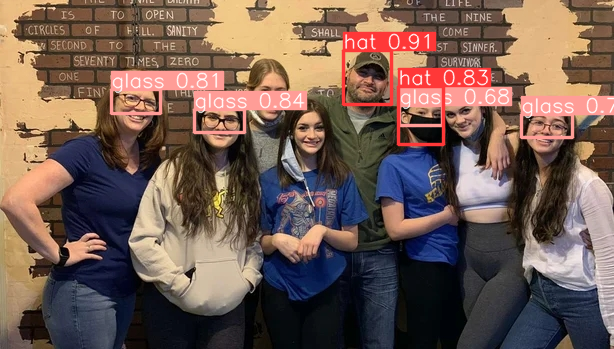

Prediction 2:


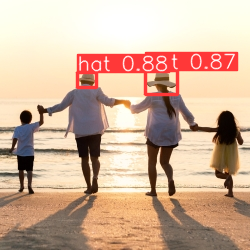

Prediction 3:


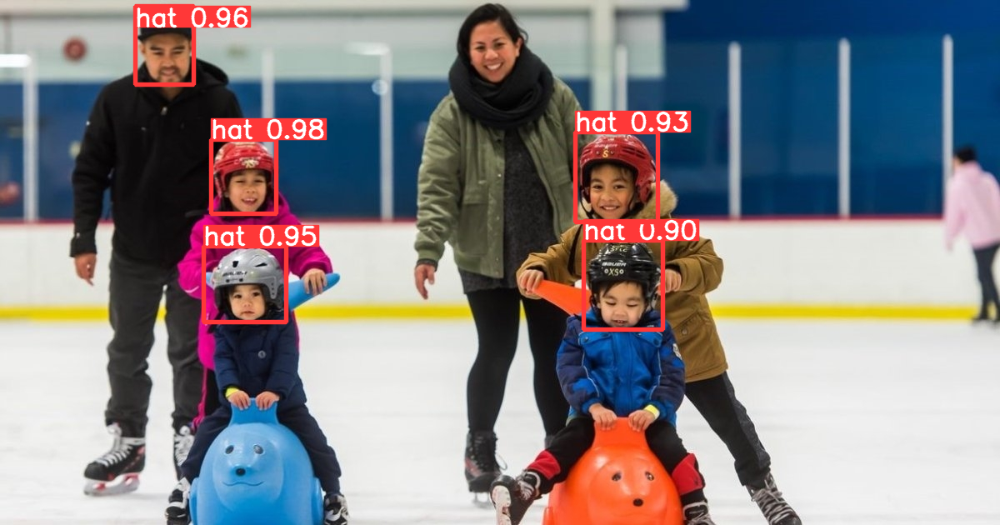

Prediction 4:


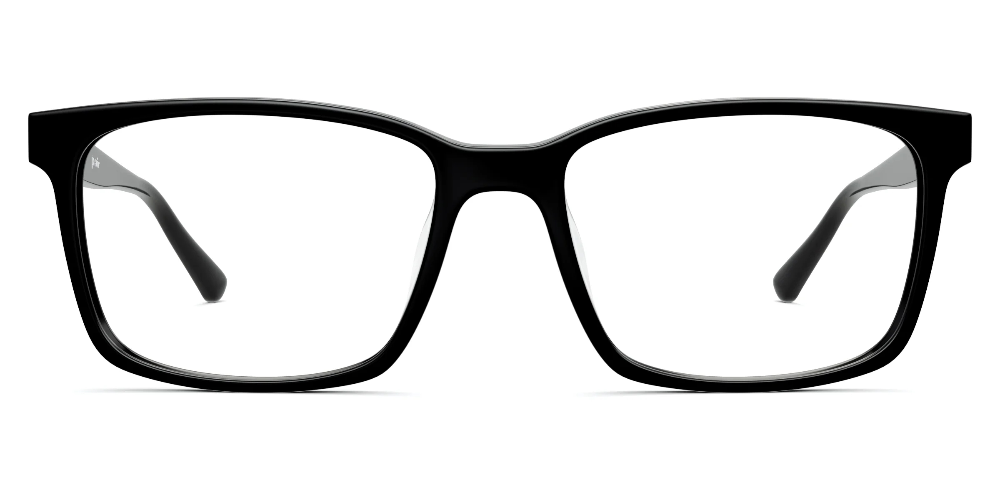

Prediction 5:


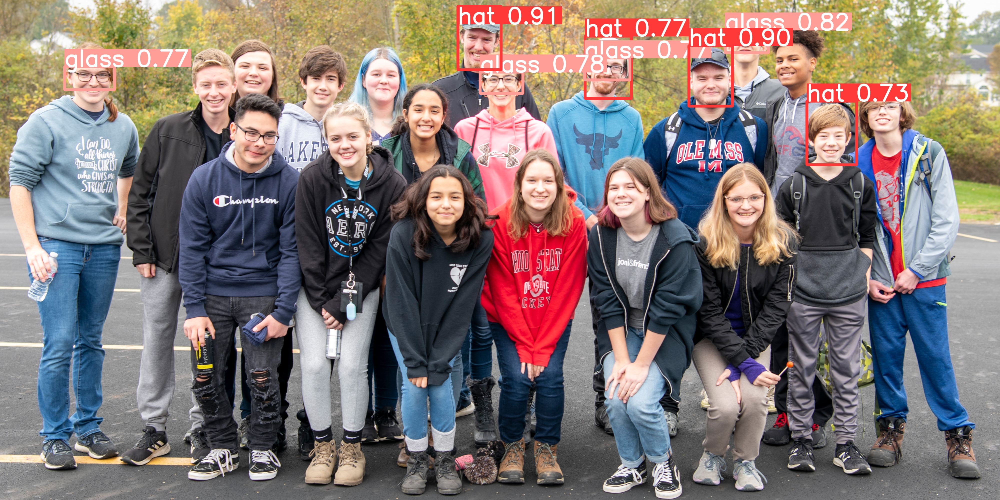

Prediction 6:


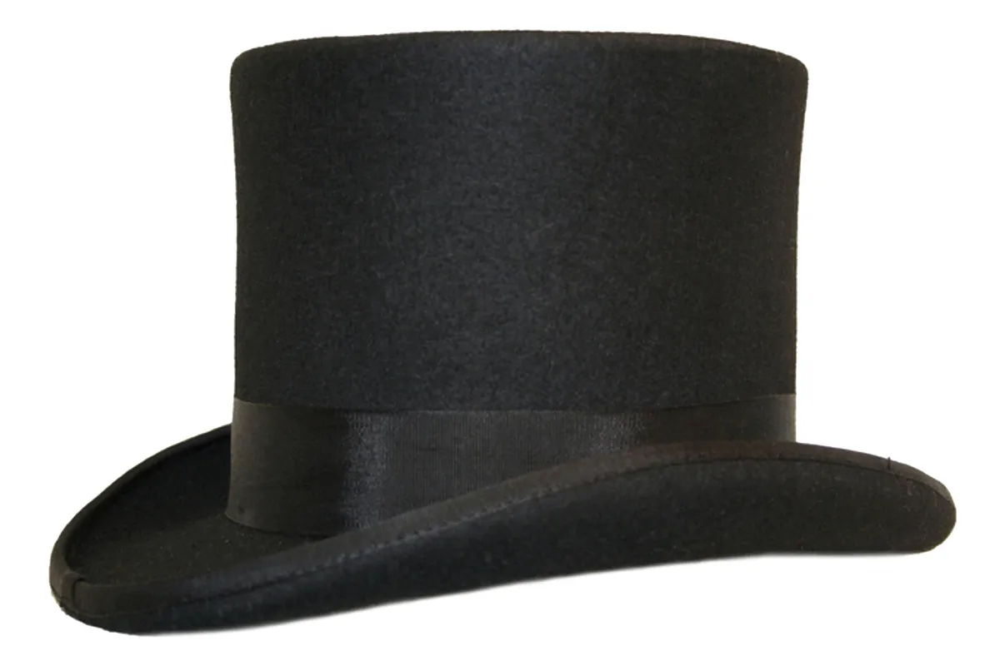

Prediction 7:


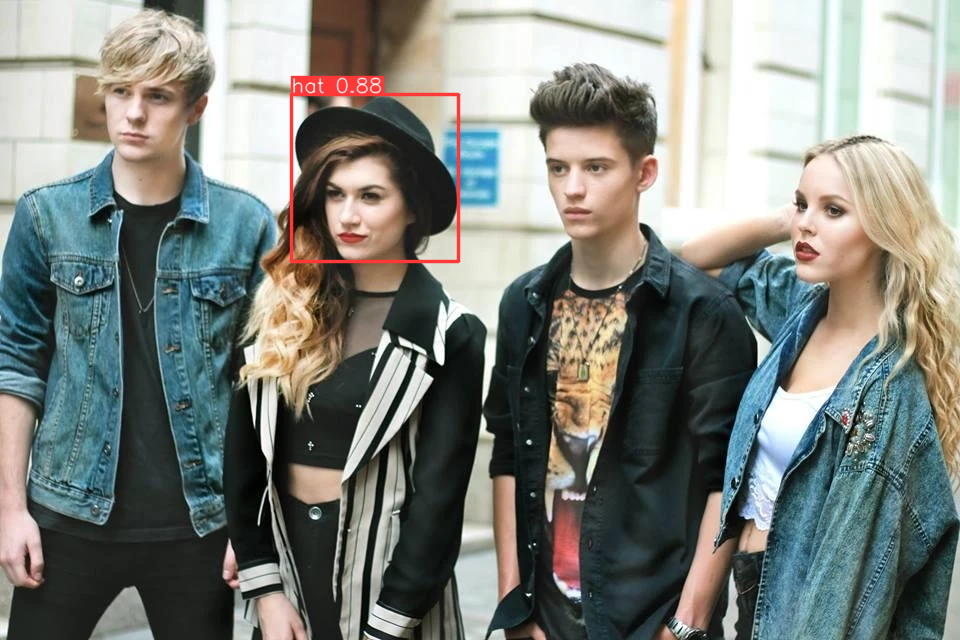

Prediction 8:


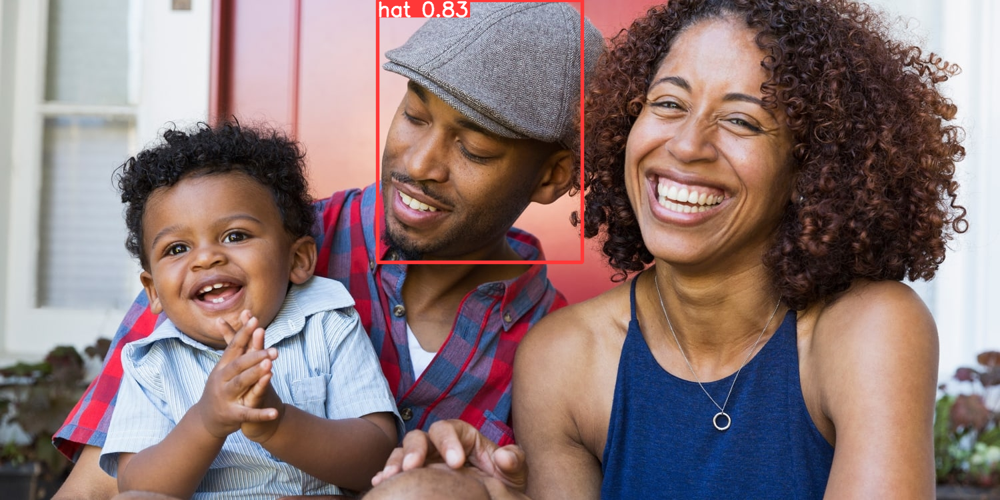

Prediction 9:


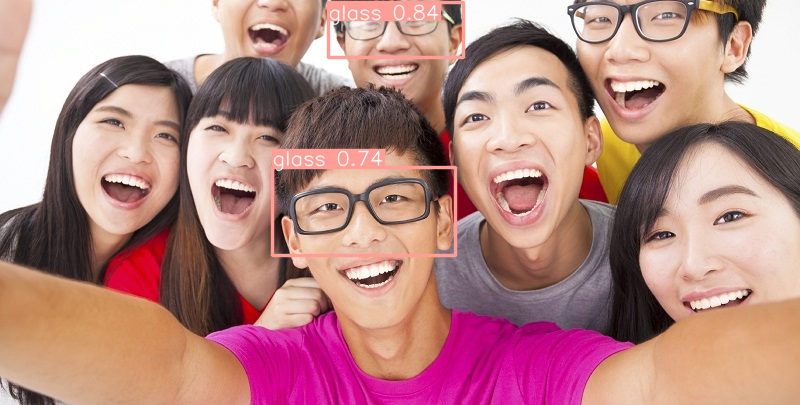

Prediction 10:


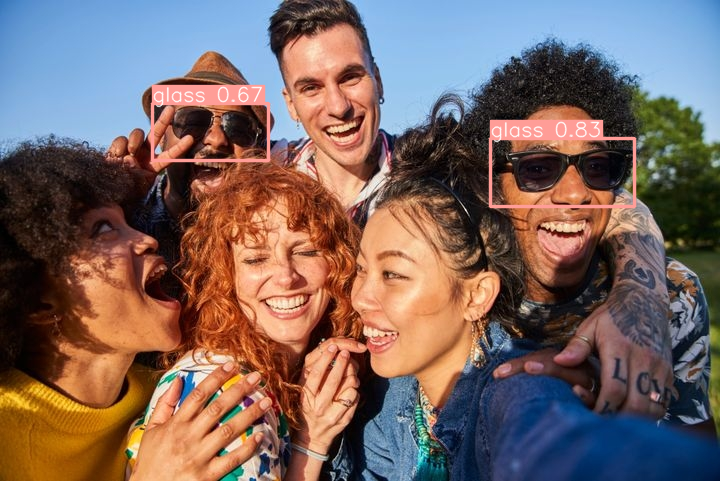

Prediction 11:


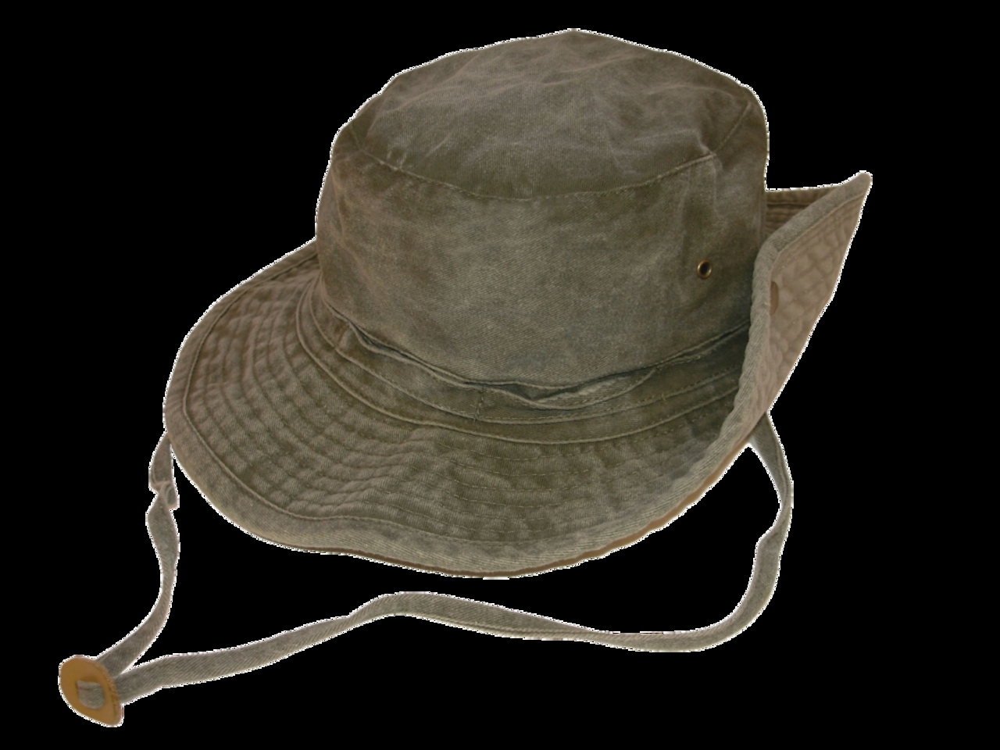

Prediction 12:


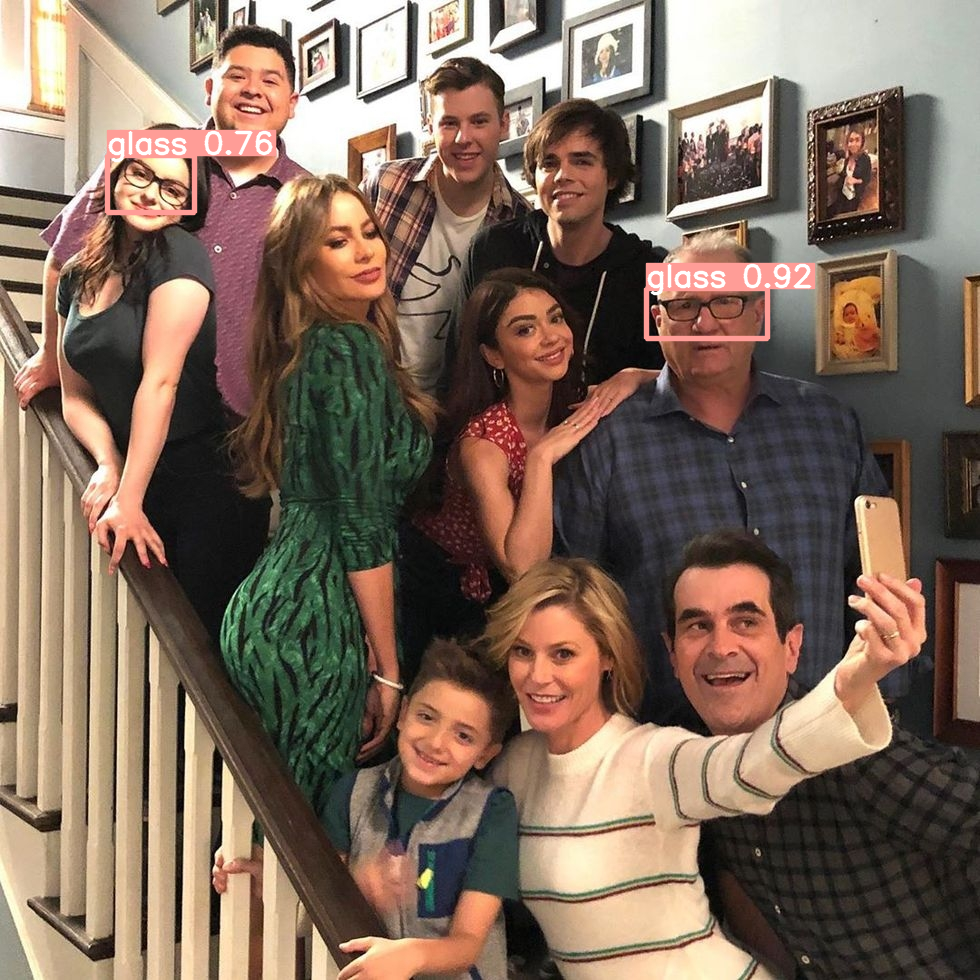

Prediction 13:


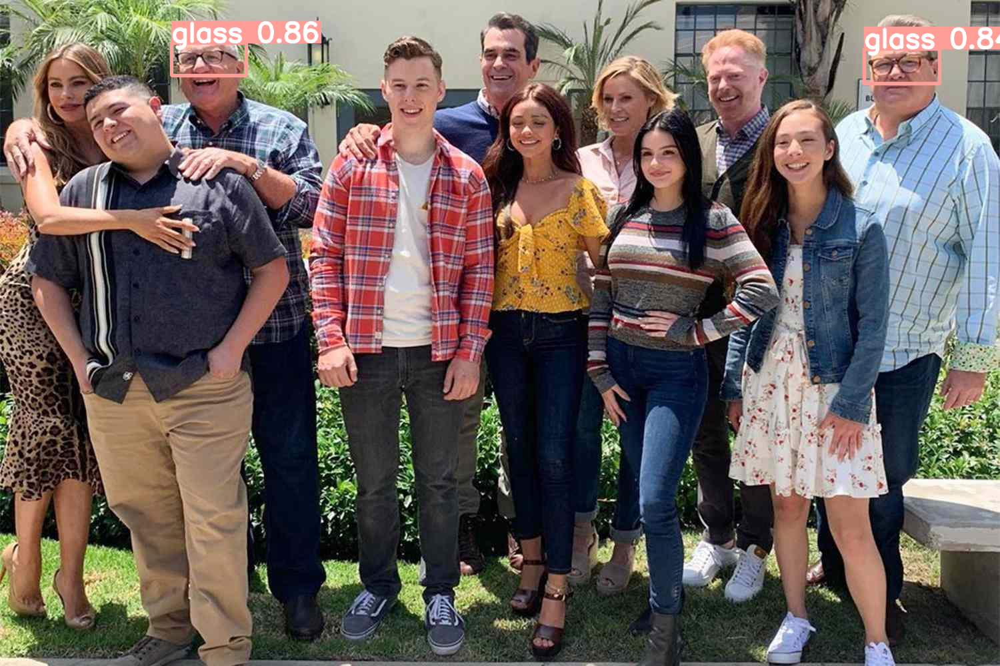

Prediction 14:


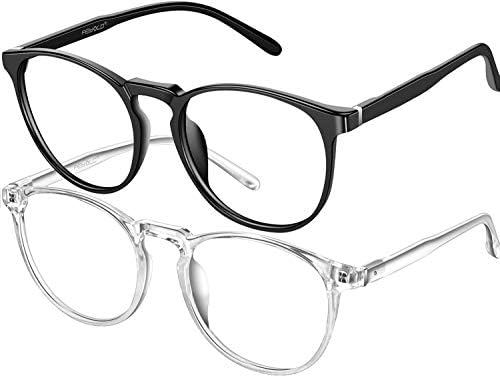

Prediction 15:


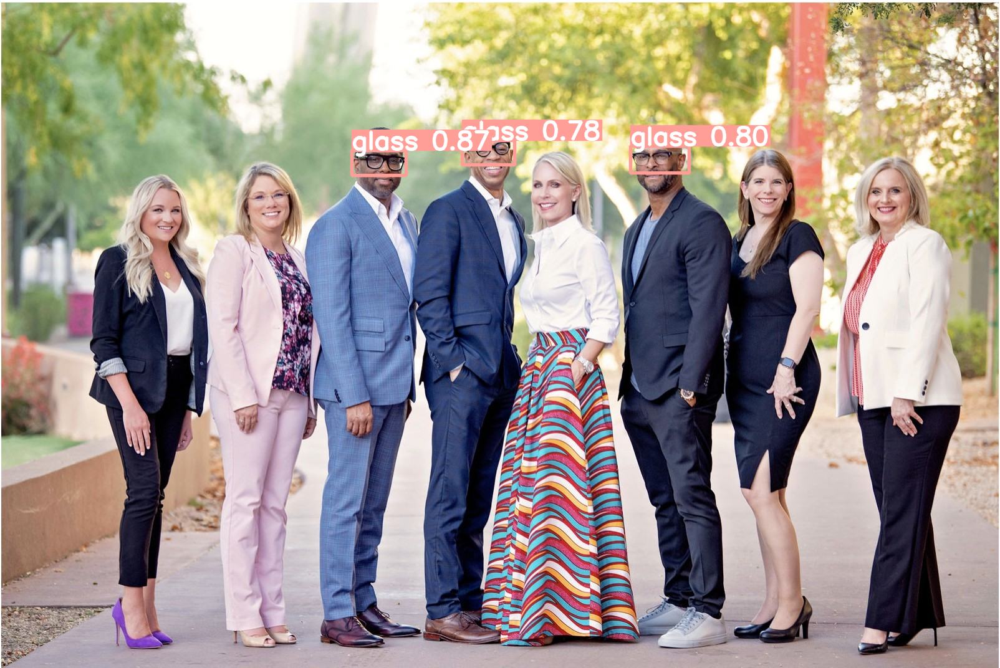

Prediction 16:


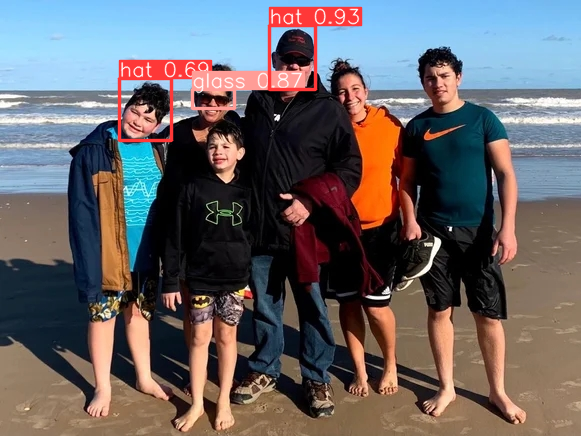

Prediction 17:


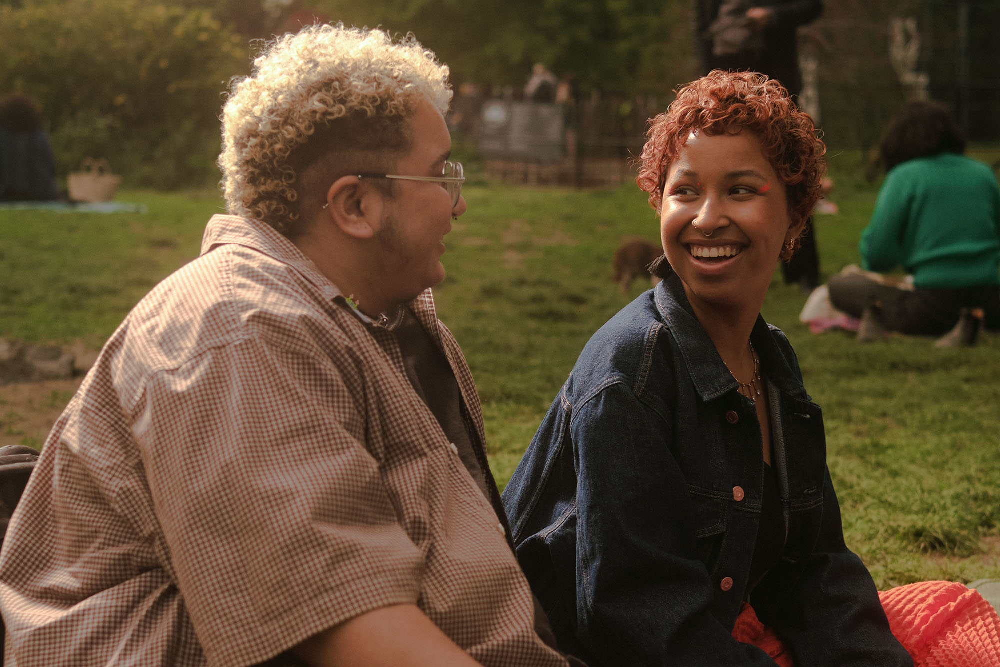

Results for image 2:
Prediction 1:


AttributeError: 'str' object has no attribute 'plot'

In [11]:
from PIL import Image
from IPython.display import display

# Visualize the results
for i, predictions in enumerate(results):
    print(f"Results for image {i + 1}:")
    for j, r in enumerate(predictions):
        print(f"Prediction {j + 1}:")
        # Plot results image
        im_bgr = r.plot()  # BGR-order numpy array
        im_rgb = Image.fromarray(im_bgr[..., ::-1])  # RGB-order PIL image
        
        # Display image in notebook
        display(im_rgb)

In [10]:
# View results
for r in results:
    print(r.boxes)  # print the Boxes object containing the detection bounding boxes
    print(r.masks)  # print the Masks object containing the detected instance masks
    print(r.keypoints)  # print the Keypoints object containing the detected keypoints
    print(r.probs)  # print the Probs object containing the detected class probabilities
    print(r.obb)  # print the OBB object containing the oriented detection bounding boxes

AttributeError: 'list' object has no attribute 'boxes'

In [ ]:
# Visualize the results
for i, r in enumerate(results):
    # Plot results image
    im_bgr = r.plot()  # BGR-order numpy array
    im_rgb = Image.fromarray(im_bgr[..., ::-1])  # RGB-order PIL image

    # Show results to screen (in supported environments)
    r.show()

    # Save results to disk
    r.save(filename=f'data_models/my_trained_models/{owner}/{new_model_name}/predicts/results{i}.jpg')